In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re

from processing import read_admissions, read_notes, preprocessing, set_token_length

In [6]:
MIMIC_PATH = '/home/yassin/Downloads/physionet.org/files/mimiciii/1.4/'

In [7]:
df_adm = read_admissions(MIMIC_PATH)

In [8]:
df_notes = read_notes(MIMIC_PATH)

In [9]:
df_notes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2083180 entries, 0 to 2083179
Data columns (total 5 columns):
 #   Column      Dtype         
---  ------      -----         
 0   SUBJECT_ID  int64         
 1   HADM_ID     float64       
 2   CHARTDATE   datetime64[ns]
 3   CATEGORY    category      
 4   TEXT        object        
dtypes: category(1), datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 65.6+ MB


In [10]:
df_adm_notes = (pd.merge(df_adm, df_notes, on = ['SUBJECT_ID','HADM_ID'], how='left')
                  .pipe(preprocessing)
                  .pipe(set_token_length))

In [11]:
print(f'{len(df_adm):,d} Admissions')
print(f'{df_adm.DURATION.mean():,.2f} (+-{df_adm.DURATION.std():.2f}) Average LOS (std)')
print(f'{len(df_adm[df_adm.OUTPUT_LABEL==1])} ({(len(df_adm[df_adm.OUTPUT_LABEL==1])/len(df_adm))*100:,.2f}%) Readmitted')
print(f'{len(df_adm_notes):,.0f} Notes')
print(f'{df_adm_notes.LEN.sum():,.0f} Tokens')

45,321 Admissions


TypeError: unsupported format string passed to Timedelta.__format__

In [12]:
sns.set_theme()

In [13]:
data = (df_adm_notes.groupby(['CATEGORY'])
                   .agg(COUNT=('CATEGORY', 'count'),
                        PERCENT=('HADM_ID', lambda c: c.nunique() / len(df_adm)),
                        LEN=('LEN', 'sum'),
                        AVG=('LEN', 'mean'),
                        MED=('LEN', 'median')))
sort = data.sort_values(by='COUNT', ascending=False).reset_index()
formatters = {'COUNT': '{:,d}'.format,
              'PERCENT': '{:.1%}'.format,
              'LEN': '{:,.0f}'.format, 
              'AVG': '{:,.0f}'.format,
              'MED': '{:,.0f}'.format}
# sort.to_latex(index=False, columns=['CATEGORY', 'COUNT', 'PERCENT', 'LEN', 'AVG'], formatters=formatters)
sort

,CATEGORY,COUNT,PERCENT,LEN,AVG,MED
0,Nursing/other,348592,0.527989,50860147,145.901647,129.0
1,Radiology,307945,0.828953,56748823,184.282333,139.0
2,Nursing,185878,0.180314,46350321,249.358832,222.0
3,ECG,119904,0.853666,3442417,28.709776,26.0
4,Physician,115640,0.178637,92677054,801.427309,760.0
5,Discharge summary,50072,0.968205,69801080,1394.014220,1312.0
6,Echo,28458,0.441892,9236166,324.554291,324.0
7,Respiratory,24432,0.074160,3708599,151.792690,155.0
8,Nutrition,7419,0.058670,2172880,292.880442,304.0
9,General,5938,0.056332,1310485,220.694678,114.0


/tmp/ipykernel_413970/1457304277.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(xlabels)
/tmp/ipykernel_413970/1457304277.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ylabels)


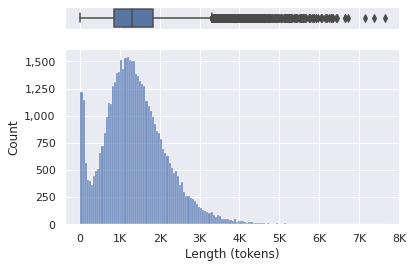

In [15]:
fig, axs = plt.subplots(2, sharex=True, gridspec_kw={'height_ratios': [.5, 4]})
data = df_adm_notes[df_adm_notes['CATEGORY'] == 'Discharge summary']
sns.boxplot(data=data, x='LEN', ax=axs[0])
sns.histplot(data=data, x='LEN', ax=axs[1])
axs[0].set_yticks([])
axs[0].set_xlabel('')
axs[1].set_xlabel('Length (tokens)')
for ax in axs:
    ylabels = ['{:,.0f}'.format(x) for x in ax.get_yticks()]
    xlabels = ['{:,.0f}'.format(x) + 'K' if x > 0 else 0 for x in ax.get_xticks()/1_000]
    ax.set_yticklabels(ylabels)
    ax.set_xticklabels(xlabels)

import tikzplotlib

# tikzplotlib.save("mimiciii_hist.tex")
# plt.savefig("mimiciii_hist.svg")

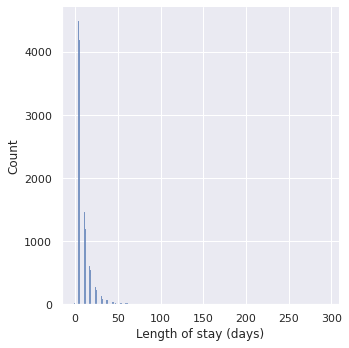

In [10]:
g = sns.displot(data=df_adm, x='DURATION')
g.set_axis_labels('Length of stay (days)')

In [11]:
total = len(df_adm)
df_adm130 = df_adm[df_adm.DURATION.between(1,30)]
print(f'{len(df_adm130) / total:.0%}')

94%


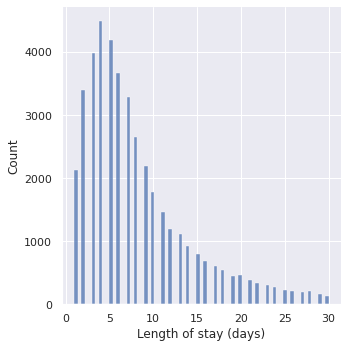

In [12]:
g = sns.displot(data=df_adm130, x='DURATION')
g.set_axis_labels('Length of stay (days)')

In [22]:
df_adm_notes130 = (pd.merge(df_adm130, df_notes, on = ['SUBJECT_ID','HADM_ID'], how='left')
                     .pipe(set_token_length))

In [23]:
print(f'{len(df_adm130):,d} Admissions')
print(f'{df_adm130.DURATION.mean():,.2f} ({df_adm130.DURATION.std()}) Average LOS (std)')
print(f'{len(df_adm130[df_adm130.OUTPUT_LABEL==1])/len(df_adm130):,.2f}% Readmitted')
print(f'{len(df_adm_notes130):,.0f} Notes')
print(f'{df_adm_notes130.LEN.sum():,.0f} Tokens')

42,472 Admissions
8.08 (6.079834546059965) Average LOS (std)
0.05% Readmitted
981,668 Notes
325,251,698 Tokens


In [24]:
data = (df_adm_notes130.groupby(['SUBJECT_ID', 'HADM_ID'])
                      .agg(OUTPUT_LABEL=('OUTPUT_LABEL', 'first'),
                           DURATION=('DURATION', 'first'),
                           LEN=('LEN', 'sum')))

<ipython-input-25-3e965724ddf2>:3: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ylabels)


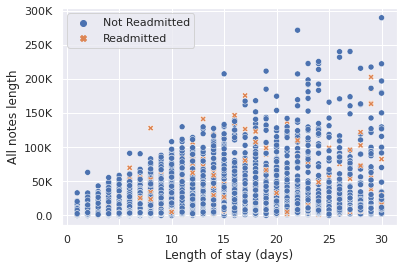

In [25]:
ax = sns.scatterplot(data=data, x='DURATION', y='LEN', hue='OUTPUT_LABEL', style='OUTPUT_LABEL')
ylabels = ['{:,.0f}'.format(x) + 'K' if x > 0 else x for x in ax.get_yticks()/1000]
ax.set_yticklabels(ylabels)
ax.set_xlabel('Length of stay (days)')
ax.set_ylabel('All notes length')
h, l = ax.get_legend_handles_labels()
ax.legend(h, ['Not Readmitted', 'Readmitted'])

In [26]:
data = (df_adm_notes130[['DURATION', 'LEN', 'OUTPUT_LABEL']].groupby(['DURATION', 'OUTPUT_LABEL'])
                                                         .sum()
                                                         .groupby('OUTPUT_LABEL')
                                                         .cumsum())

/home/yassin/.local/lib/python3.8/site-packages/seaborn/axisgrid.py:132: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  figlegend = self.fig.legend(handles, labels, **kwargs)
<ipython-input-28-b6b970c222f2>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ylabels)


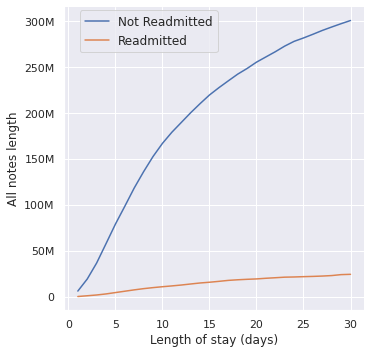

In [28]:
g = sns.relplot(data=data, x='DURATION', y='LEN', hue='OUTPUT_LABEL', kind='line', legend=False)
g.set_xlabels('Length of stay (days)')
g.set_ylabels('All notes length')
g.add_legend(bbox_to_anchor=(.13, .94), loc = 'upper left', prop={'size':12}, labels=['Not Readmitted', 'Readmitted'], frameon=True)
for axs in g.axes:
    ax = axs[0]
    ylabels = ['{:,.0f}'.format(x) + 'M' if x > 0 else 0 for x in ax.get_yticks()/1_000_000]
    ax.set_yticklabels(ylabels)